# TS Endothelial

In [1]:
import os
import sys
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import numpy
import pickle
from scipy.sparse import issparse, csr_matrix
import seaborn as sns
import matplotlib.pyplot as plt

def getFiles(category=None, model=None):
    h5ad_files = [] # list of all files
    targets    = [] # list of target
    for root, dirs, files in os.walk(DATAPATH):
        for file in files:
            if file.endswith('.h5ad'):
                h5ad_files.append(os.path.join(root, file))
    for root, dirs, files in os.walk(EMBPATH):
        for file in files:
            if file.endswith('.h5ad'):
                h5ad_files.append(os.path.join(root, file))
    for file in h5ad_files:
        if category is None and model in file:
            targets.append(file)
        elif model is None and category in file:
            targets.append(file)
        elif model == 'raw' and category in file:
            if 'geneformer' not in file and 'scgpt' not in file and 'Tgpt' not in file:
                targets.append(file)
        elif model is not None and category is not None and model in file and category in file:
            targets.append(file)
    return targets

def format_number(x):
    if isinstance(x, (float, np.float64)):
        return f"{x:.2g}"
    return x

DATAPATH = "/nfs/turbo/umms-indikar/shared/projects/DGC/data/tabula_sapiens/extract/"
EMBPATH  = "/nfs/turbo/umms-indikar/shared/projects/foundation_models/experiments/tabulaSapiens"

In [2]:
models = ['raw', 'geneformer', 'Tgpt', 'scgpt']
ads = {}
for m in models:
    print(m)
    ads[m] = sc.read_h5ad(getFiles(category='Kidney', model=m)[0])

raw
geneformer
Tgpt
scgpt


## Dimension Reductions

In [3]:
for key, adata in ads.items():
    print(key)
    if 'X_umap' not in adata.obsm:
        sc.pp.pca(adata)
        sc.pp.neighbors(adata)
        sc.tl.umap(adata)

raw
geneformer
Tgpt
scgpt


In [4]:
for key, adata in ads.items():
    print(key)
    if 'X_umap' not in adata.obsm:
        sc.pp.pca(adata)
        sc.pp.neighbors(adata)
        sc.tl.umap(adata)

raw
geneformer
Tgpt
scgpt


## Visualizations

### UMAP

In [5]:
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns

def plot_umap_comparison(ads, attribute=None):
    fig, axes = plt.subplots(2, 2, figsize=(8, 8), dpi=250)
    axes = axes.flatten()
    handles, labels = None, None
    sm = None  # For the scalar mappable (color bar)
    lut = None
    
    # Create a consistent colormap for categorical data
    unique_categories = None
    if attribute:
        # Combine all unique categories from the attribute across all datasets
        unique_categories = set()
        for adata in ads.values():
            if attribute in adata.obs:
                if adata.obs[attribute].dtype.name == 'category':
                    unique_categories.update(adata.obs[attribute].cat.categories)


        if unique_categories:
            unique_categories = sorted(unique_categories)
            palette = sns.color_palette("husl", len(unique_categories))
            lut = dict(zip(unique_categories, palette))

    
    for ax, (key, adata) in zip(axes, ads.items()):
        # sc.pl.umap(adata, color=attribute, ax=ax, show=False, title=key, palette=lut)
        if attribute and lut:
            sc.pl.umap(adata, color=attribute, ax=ax, show=False, title=key, palette=lut)
        else:
            sc.pl.umap(adata, color=attribute, ax=ax, show=False, title=key)
        # ax.set_title(key.upper())

        ax.set_title(key.upper())

        # Get the handles and labels for the first plot to create a legend
        if handles is None and labels is None:
            handles, labels = ax.get_legend_handles_labels()
        
        # If a color bar exists, store the scalar mappable
        if sm is None and attribute:
            color_vector = adata.obs[attribute] if attribute in adata.obs else adata.var[attribute]
            if color_vector.dtype.name == 'category':
                sm = None  # No scalar mappable for categorical data
            else:
                sm = plt.cm.ScalarMappable(cmap='viridis')
                sm.set_array([])

        # Turn off the legend for each subplot
        if ax.get_legend() is not None:
            ax.get_legend().remove()

        # Turn off the color bar for each subplot if it exists
        if hasattr(ax, 'collections'):
            for collection in ax.collections:
                if isinstance(collection, plt.cm.ScalarMappable):
                    if collection.colorbar is not None:
                        collection.colorbar.remove()

    # Create a single legend for all subplots
    if handles and labels:
        ncol = int(np.ceil(len(labels) / 20))
        fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), ncol=ncol, edgecolor='k')
        
    # Create a single color bar for continuous data
    if sm:
        cbar = fig.colorbar(sm, ax=axes, orientation='vertical', fraction=0.02, pad=0.04)
        cbar.set_label(attribute)
        cbar.ax.set_position([1.15, 0.1, 0.03, 0.8])  # [left, bottom, width, height]
    plt.tight_layout()
    sns.despine()
    plt.show()

In [6]:
ads['raw'].obs.columns

Index(['organ_tissue', 'method', 'donor', 'anatomical_information',
       'n_counts_UMIs', 'n_genes', 'cell_ontology_class', 'free_annotation',
       'manually_annotated', 'compartment', 'gender'],
      dtype='object')

organ_tissue


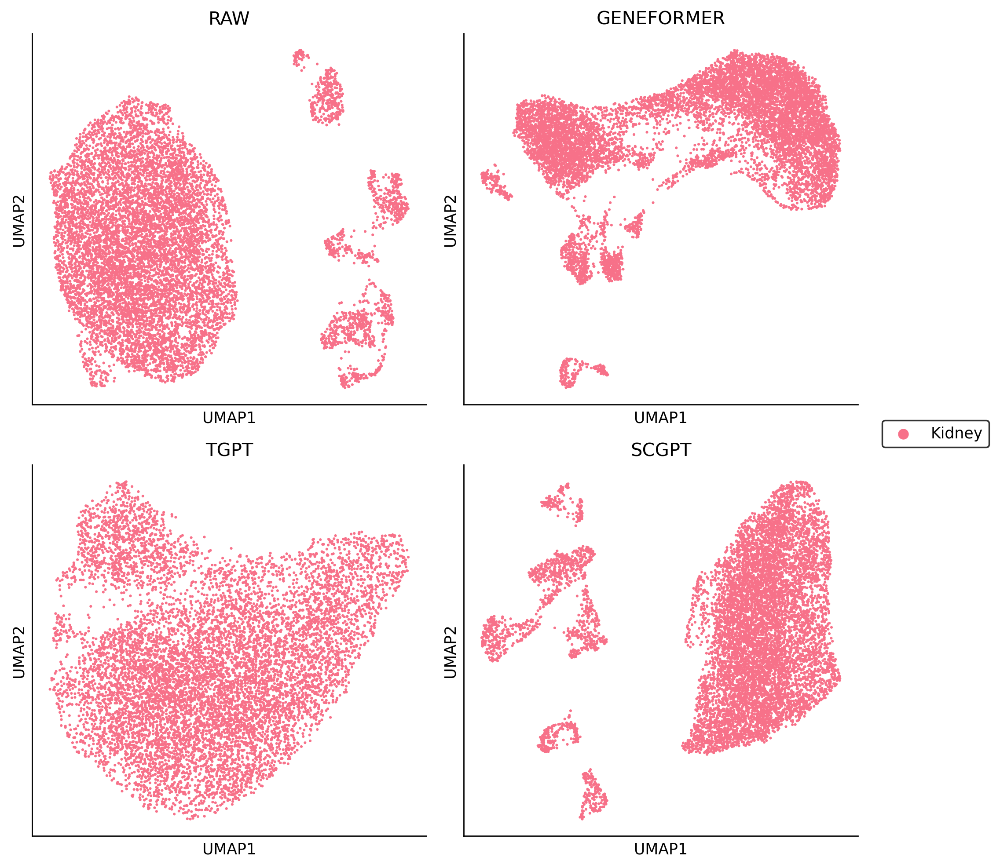

method


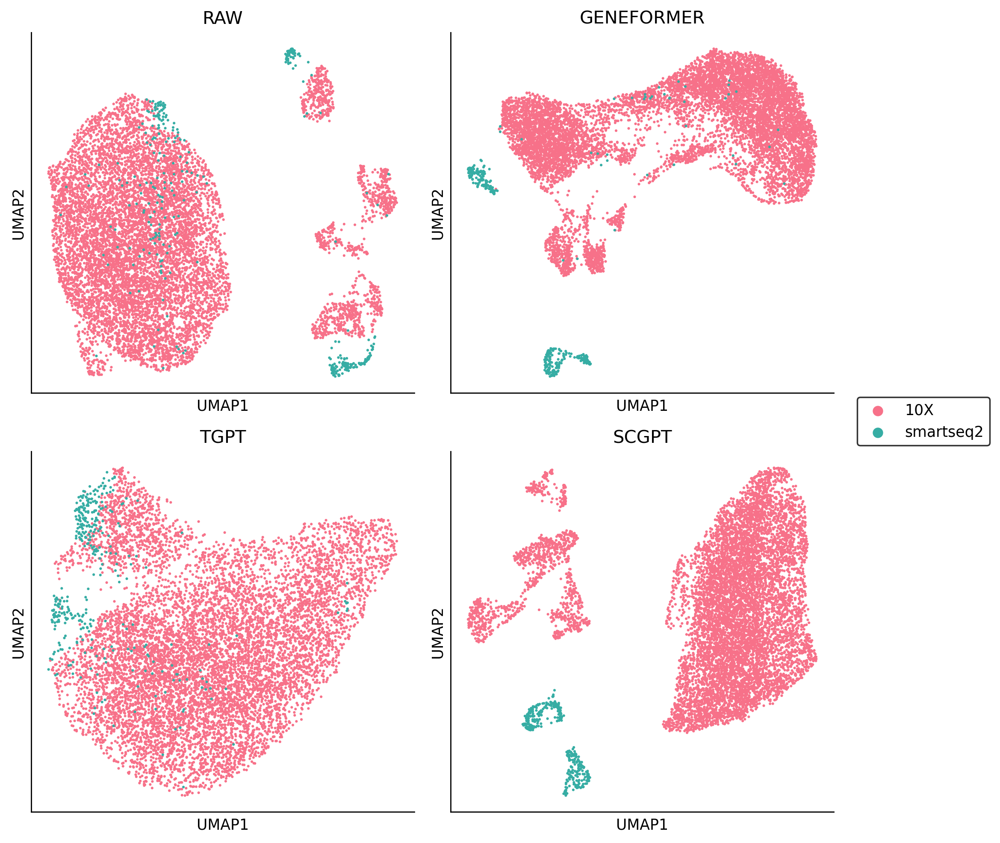

donor


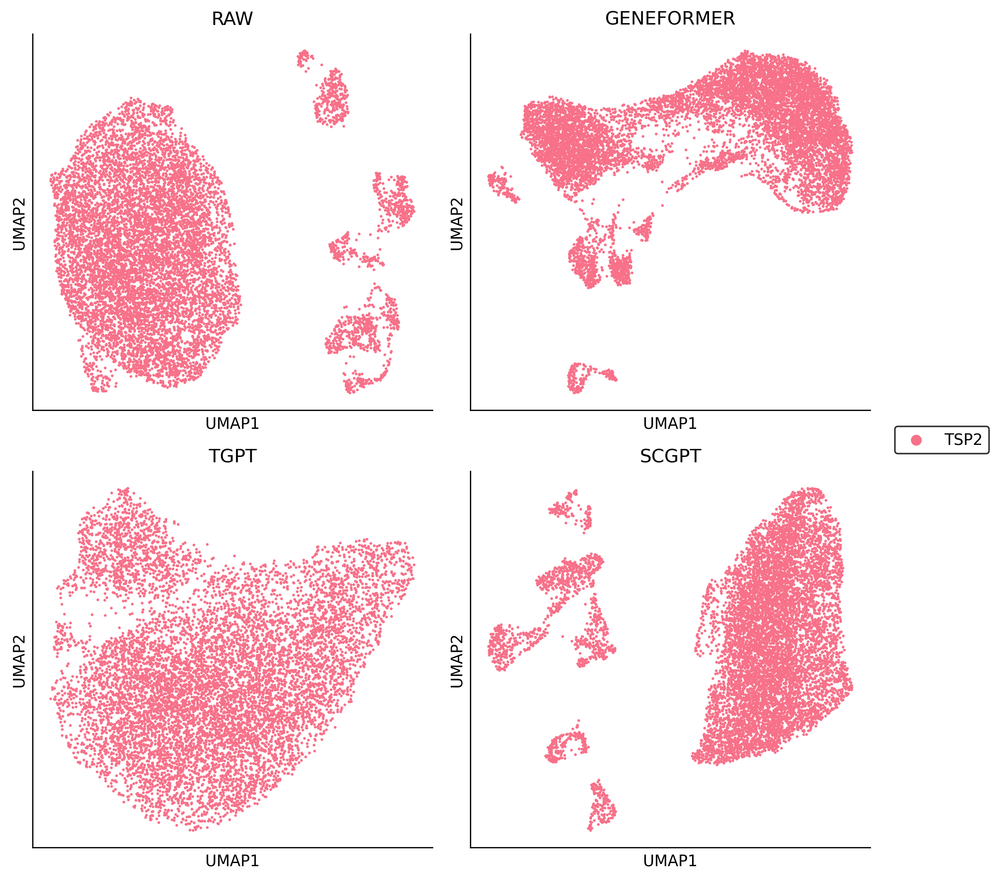

anatomical_information


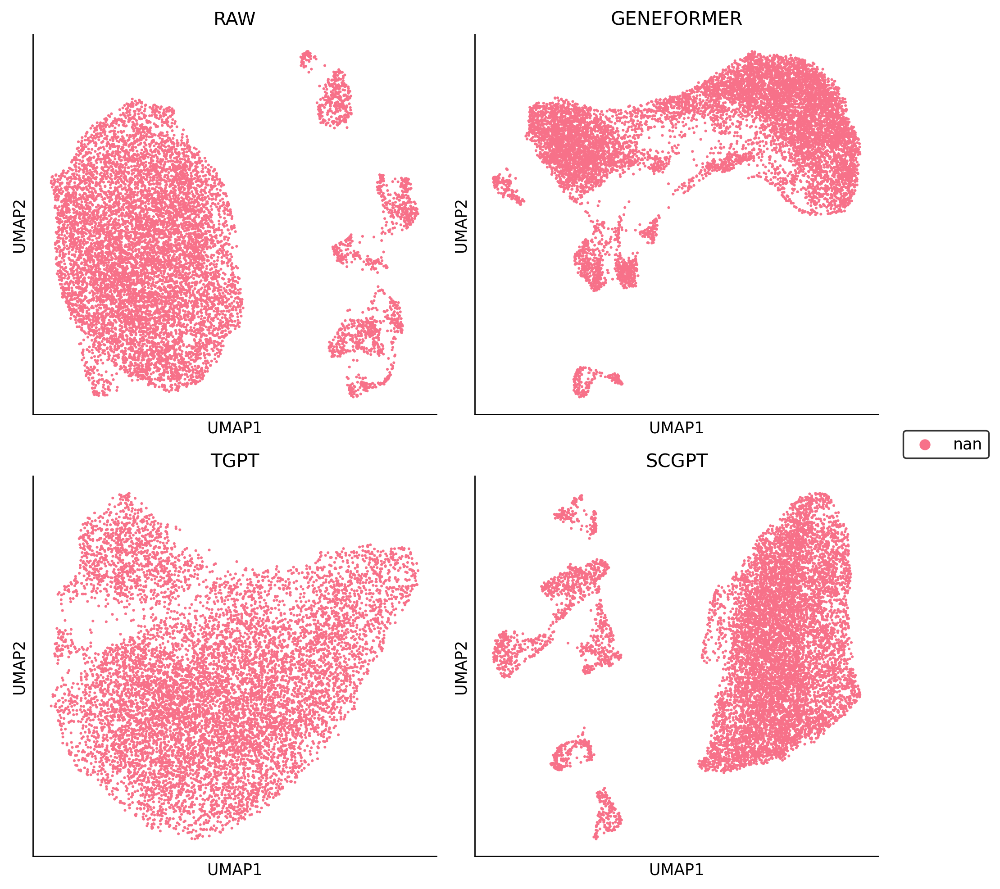

n_counts_UMIs


/tmp/ipykernel_3055367/2135750514.py:73: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


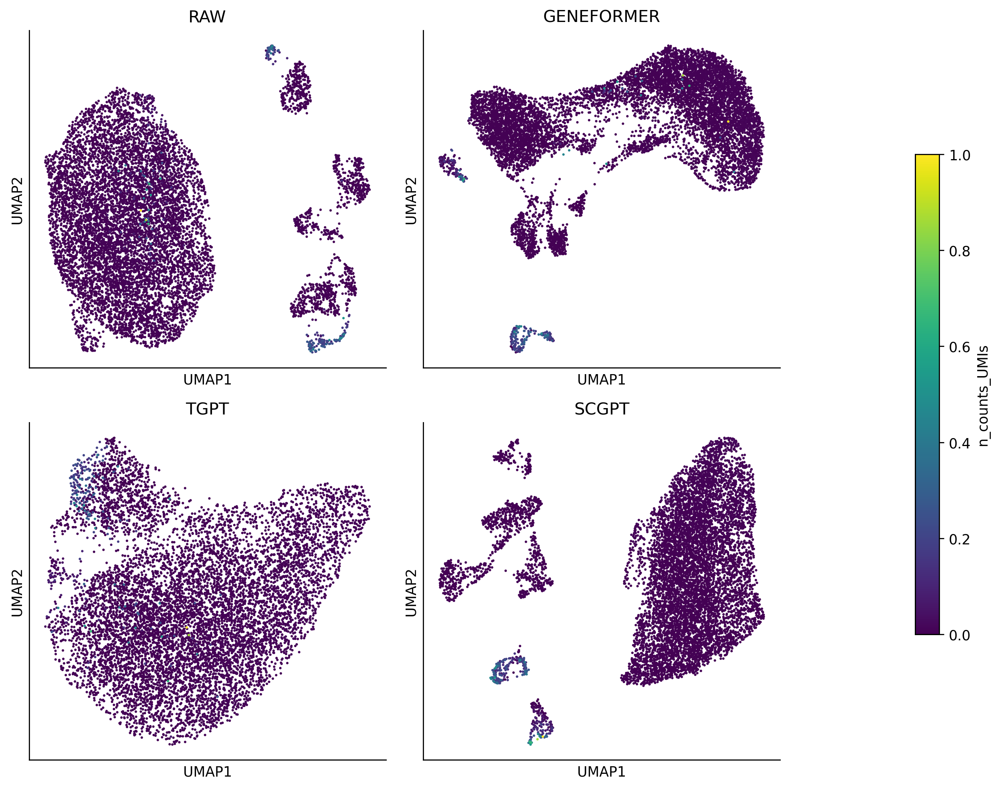

n_genes


/tmp/ipykernel_3055367/2135750514.py:73: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


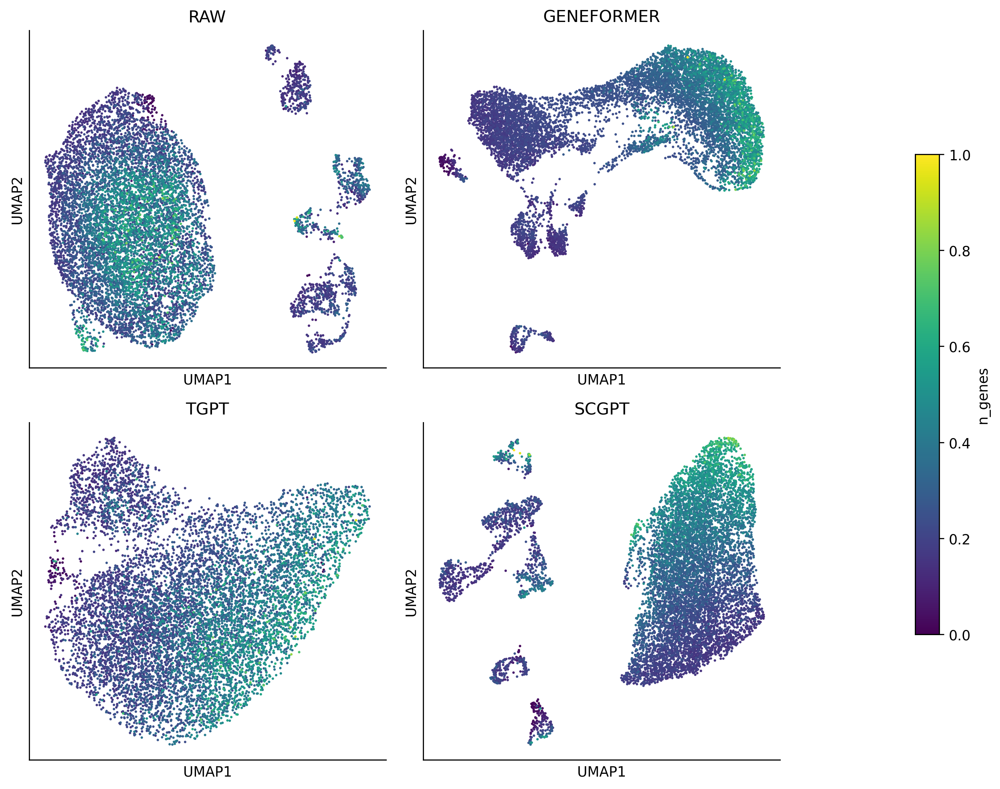

cell_ontology_class


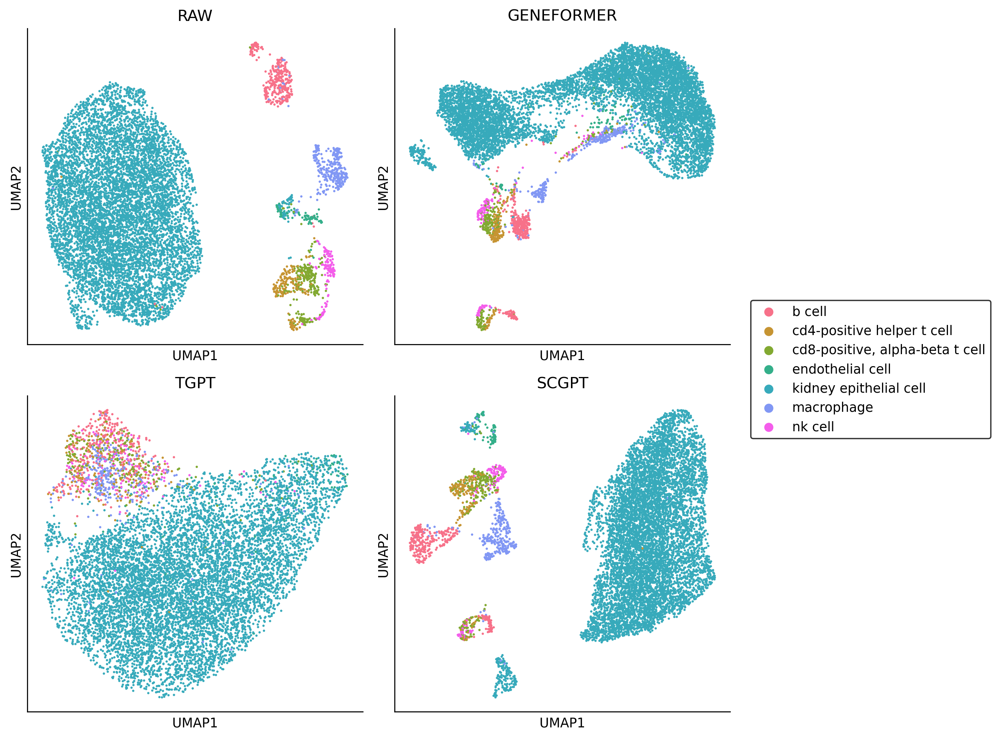

free_annotation


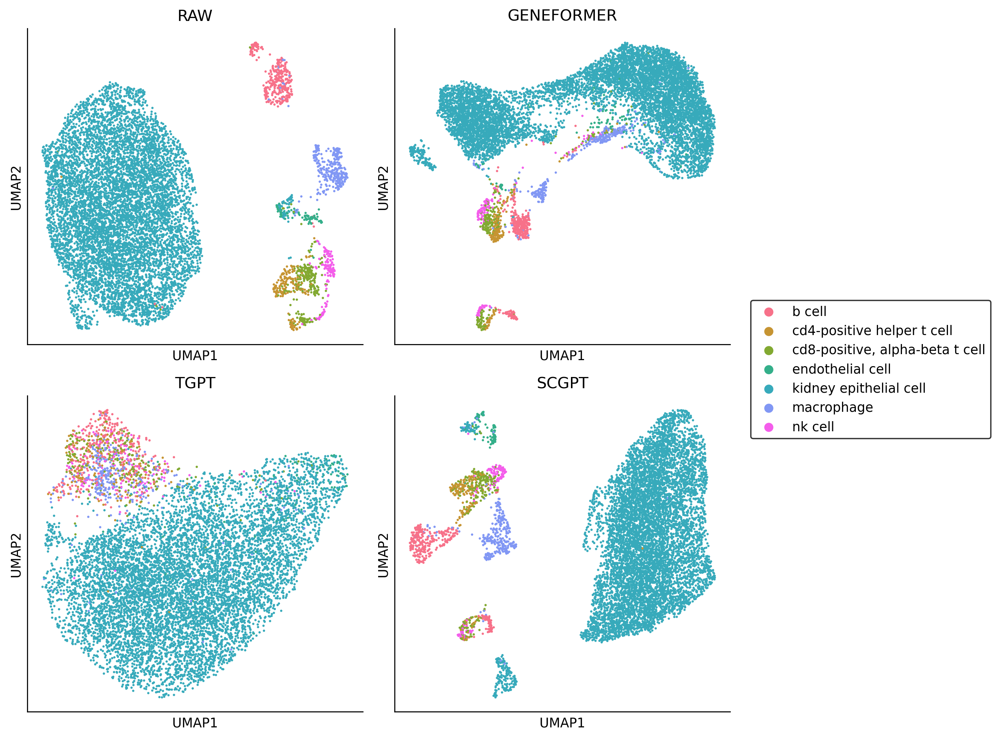

compartment


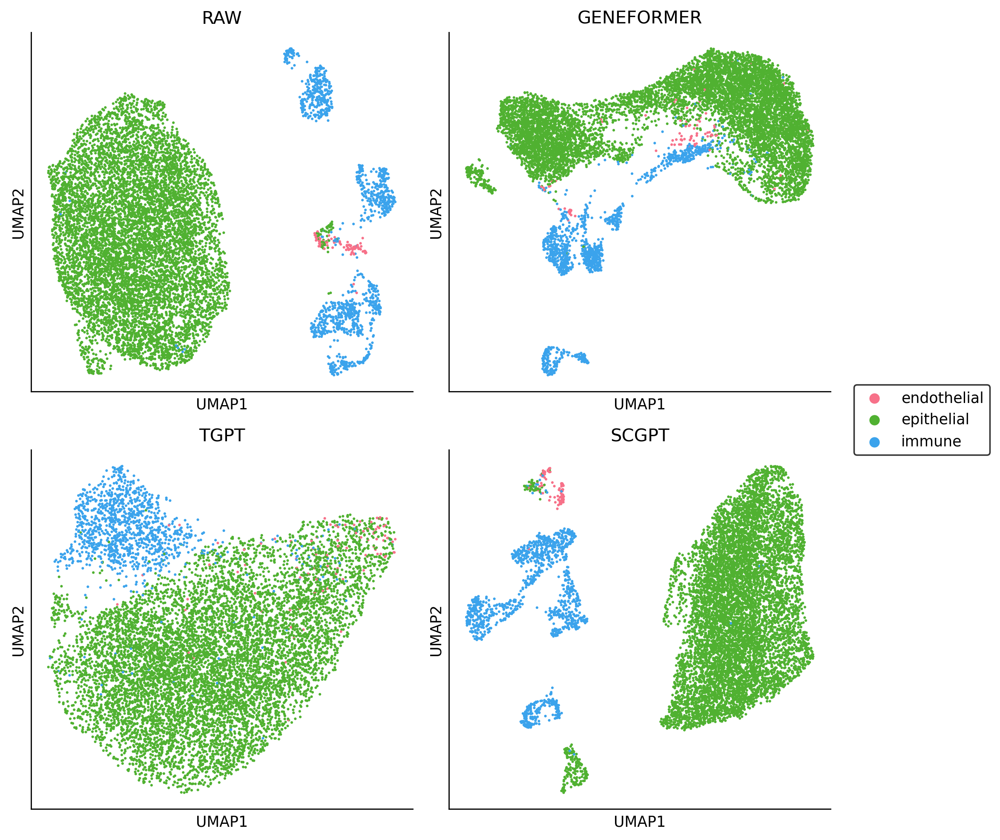

gender


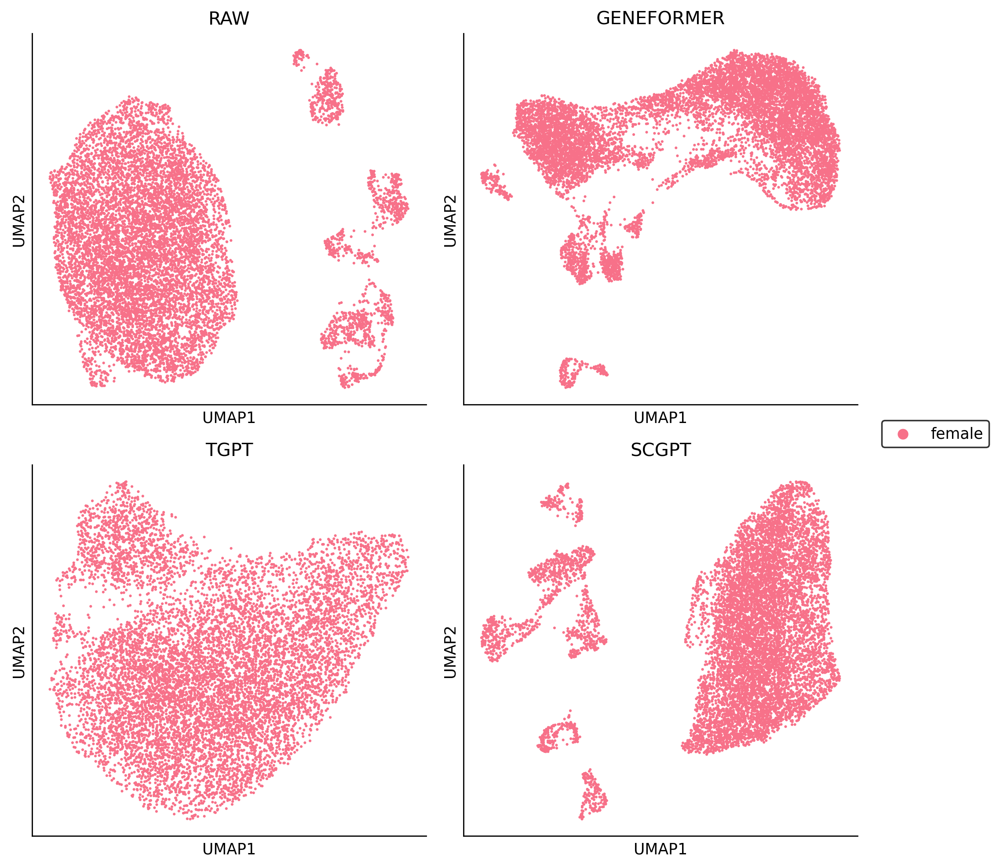

In [7]:
for attribute in ads['raw'].obs.columns:
    if attribute in ['manually_annotated']:
        continue
    print(attribute)
    plot_umap_comparison(ads, attribute=attribute)

### PCA

In [8]:
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns

def plot_pca_comparison(ads, attribute=None):
    fig, axes = plt.subplots(2, 2, figsize=(8, 8), dpi=250)
    axes = axes.flatten()
    handles, labels = None, None
    sm = None  # For the scalar mappable (color bar)
    lut = None
    
    # Create a consistent colormap for categorical data
    unique_categories = None
    if attribute:
        # Combine all unique categories from the attribute across all datasets
        unique_categories = set()
        for adata in ads.values():
            if attribute in adata.obs:
                if adata.obs[attribute].dtype.name == 'category':
                    unique_categories.update(adata.obs[attribute].cat.categories)


        if unique_categories:
            unique_categories = sorted(unique_categories)
            palette = sns.color_palette("husl", len(unique_categories))
            lut = dict(zip(unique_categories, palette))

    
    for ax, (key, adata) in zip(axes, ads.items()):
        # sc.pl.umap(adata, color=attribute, ax=ax, show=False, title=key, palette=lut)
        if attribute and lut:
            sc.pl.pca(adata, color=attribute, ax=ax, show=False, title=key, palette=lut)
        else:
            sc.pl.pca(adata, color=attribute, ax=ax, show=False, title=key)
        # ax.set_title(key.upper())

        ax.set_title(key.upper())

        # Get the handles and labels for the first plot to create a legend
        if handles is None and labels is None:
            handles, labels = ax.get_legend_handles_labels()
        
        # If a color bar exists, store the scalar mappable
        if sm is None and attribute:
            color_vector = adata.obs[attribute] if attribute in adata.obs else adata.var[attribute]
            if color_vector.dtype.name == 'category':
                sm = None  # No scalar mappable for categorical data
            else:
                sm = plt.cm.ScalarMappable(cmap='viridis')
                sm.set_array([])

        # Turn off the legend for each subplot
        if ax.get_legend() is not None:
            ax.get_legend().remove()

        # Turn off the color bar for each subplot if it exists
        if hasattr(ax, 'collections'):
            for collection in ax.collections:
                if isinstance(collection, plt.cm.ScalarMappable):
                    if collection.colorbar is not None:
                        collection.colorbar.remove()

    # Create a single legend for all subplots
    if handles and labels:
        ncol = int(np.ceil(len(labels) / 20))
        fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), ncol=ncol, edgecolor='k')
        
    # Create a single color bar for continuous data
    if sm:
        cbar = fig.colorbar(sm, ax=axes, orientation='vertical', fraction=0.02, pad=0.04)
        cbar.set_label(attribute)
        cbar.ax.set_position([1.15, 0.1, 0.03, 0.8])  # [left, bottom, width, height]
    plt.tight_layout()
    sns.despine()
    plt.show()

organ_tissue


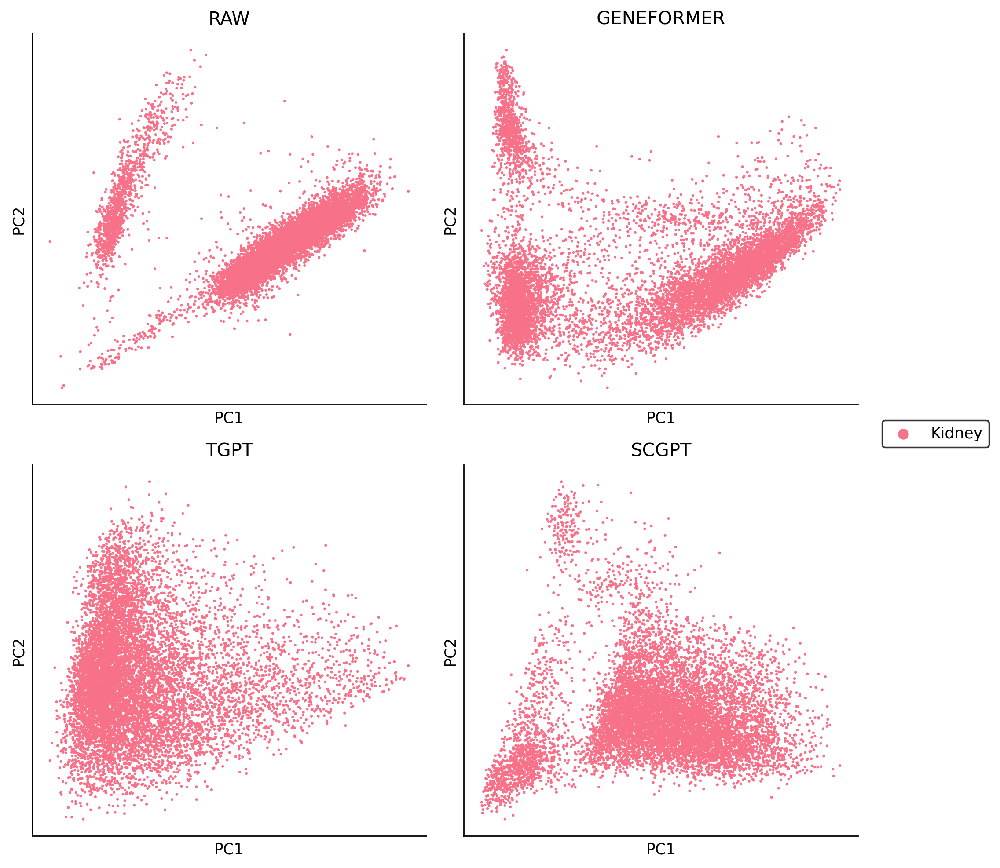

method


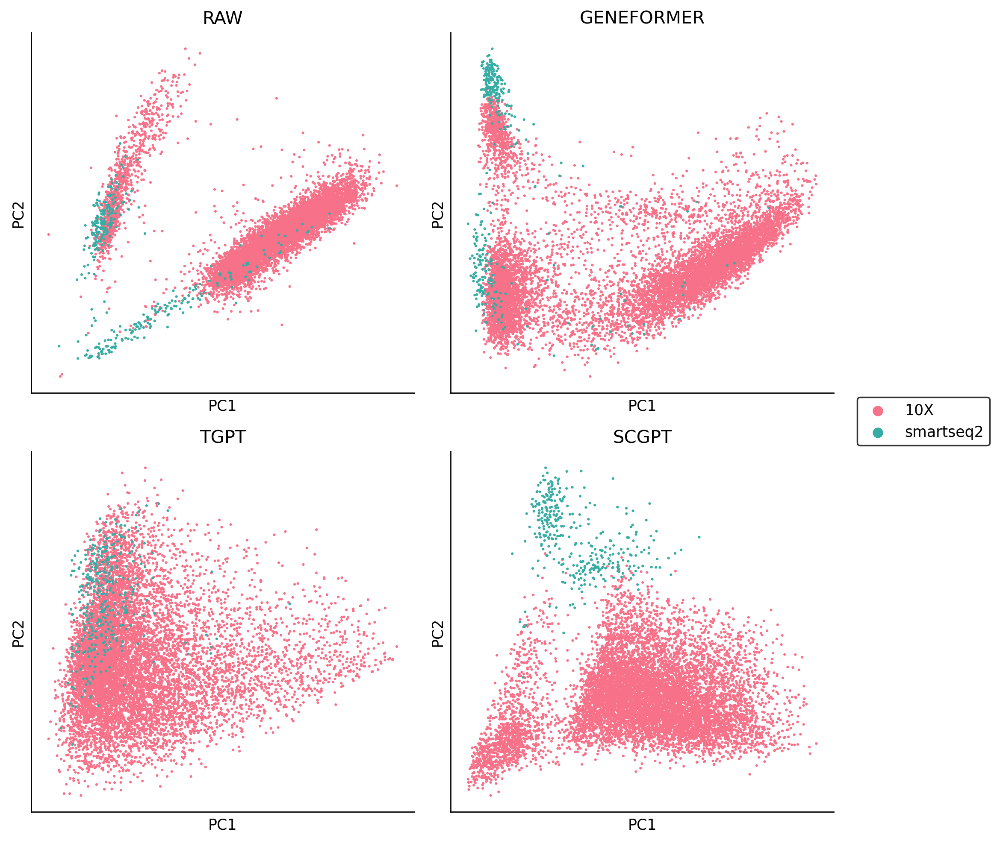

donor


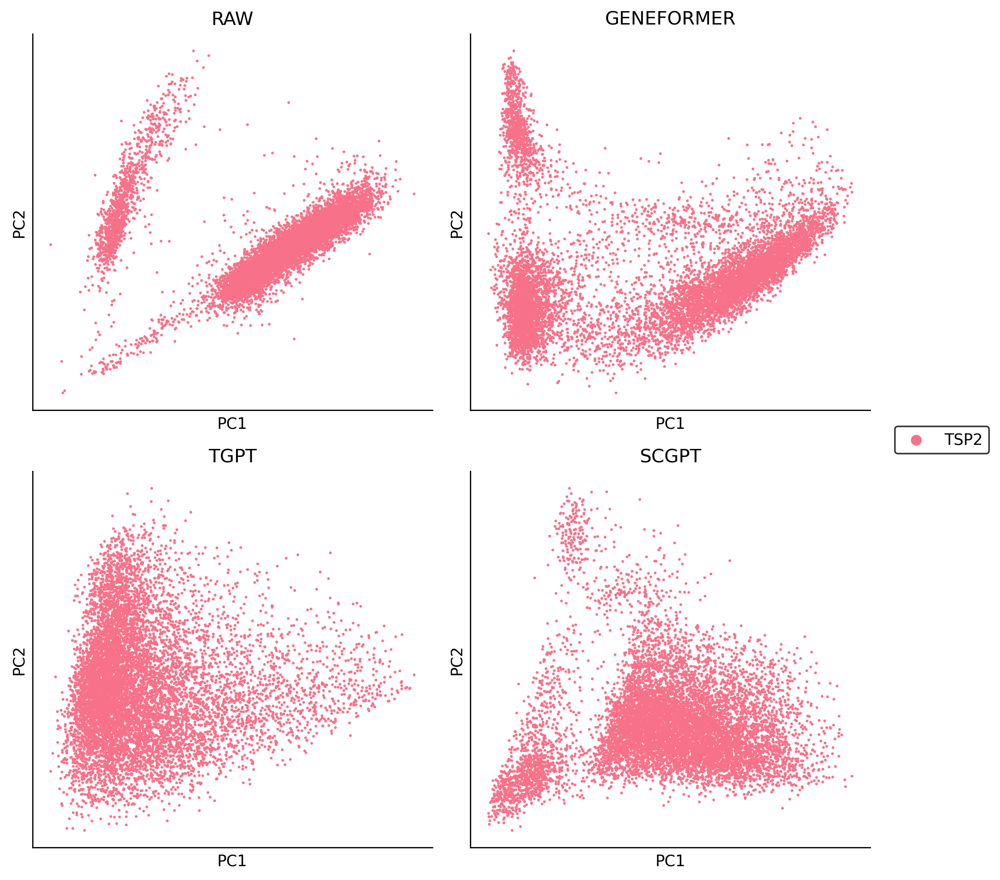

anatomical_information


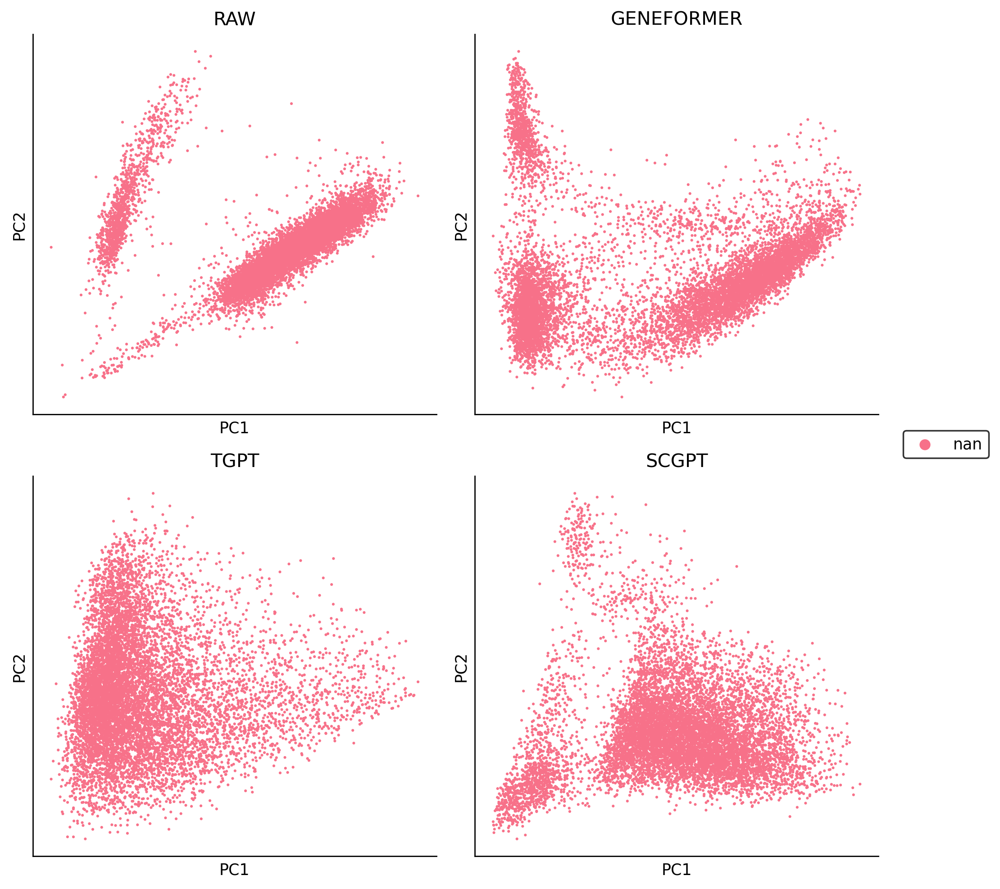

n_counts_UMIs


/tmp/ipykernel_3055367/2628052568.py:73: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


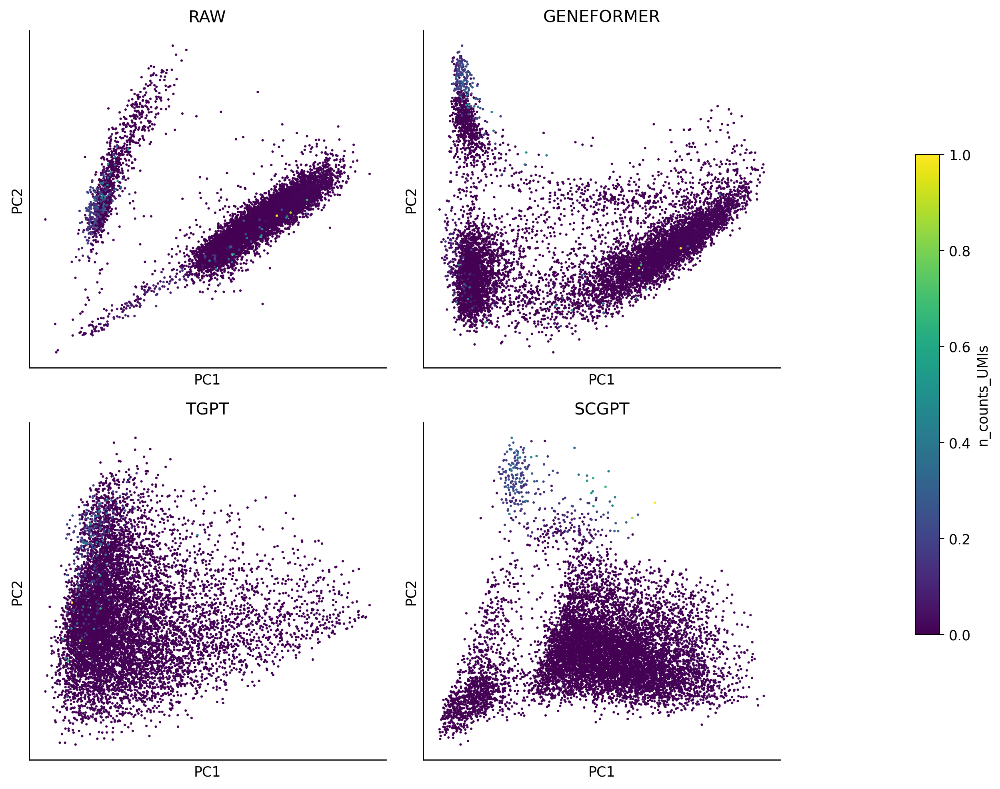

n_genes


/tmp/ipykernel_3055367/2628052568.py:73: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


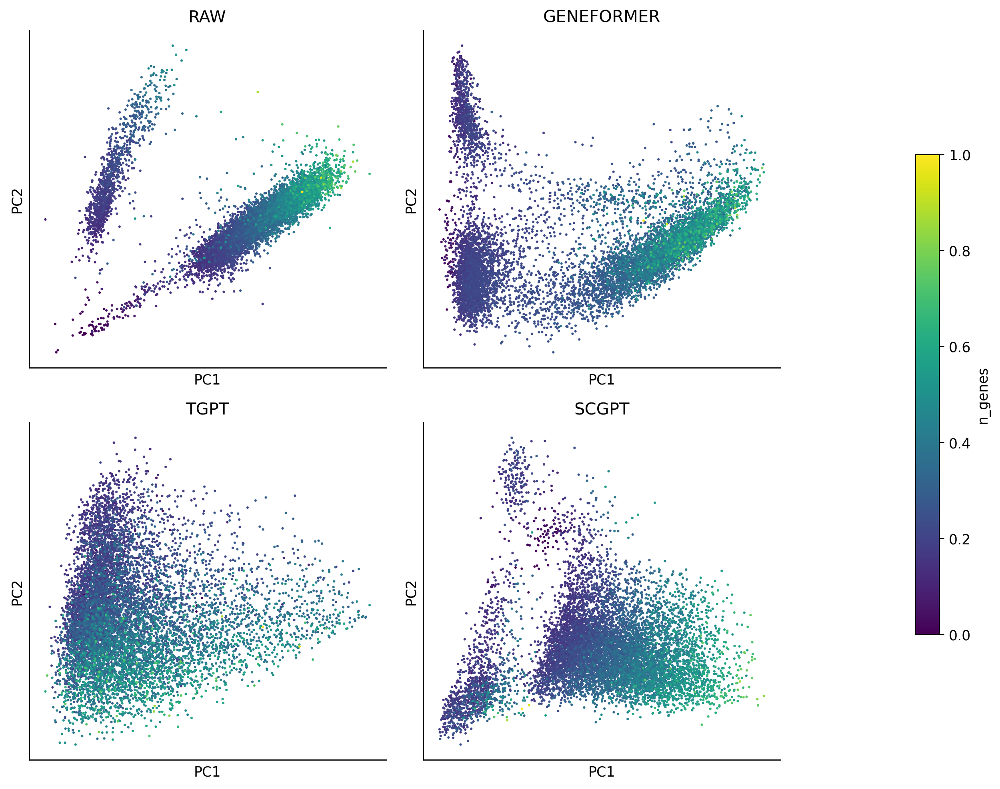

cell_ontology_class


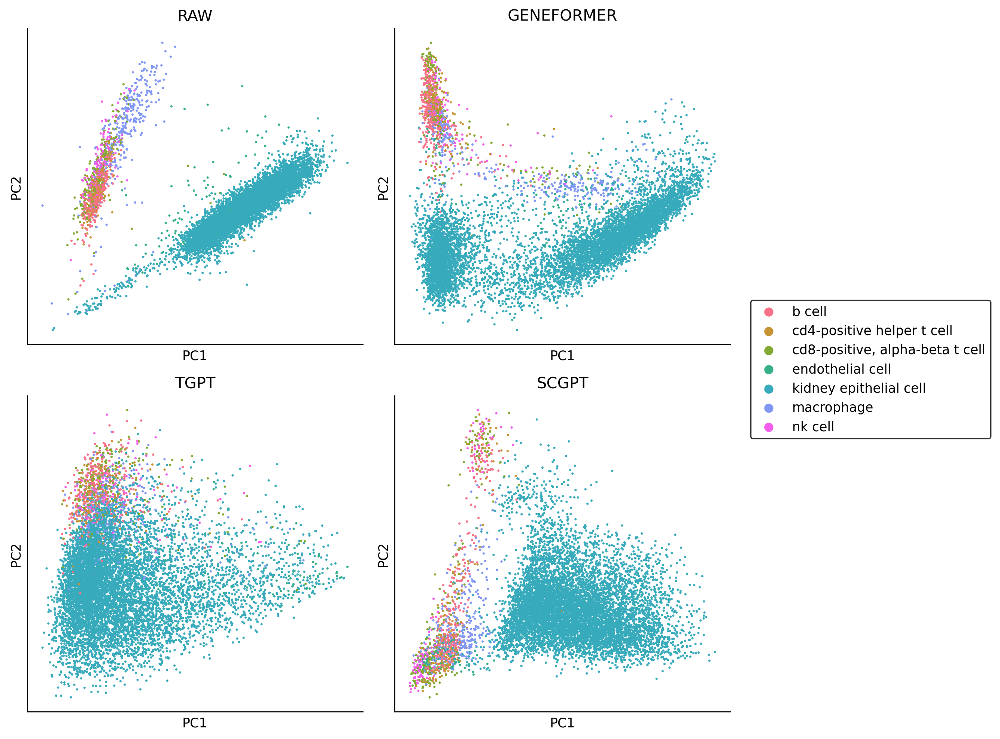

free_annotation


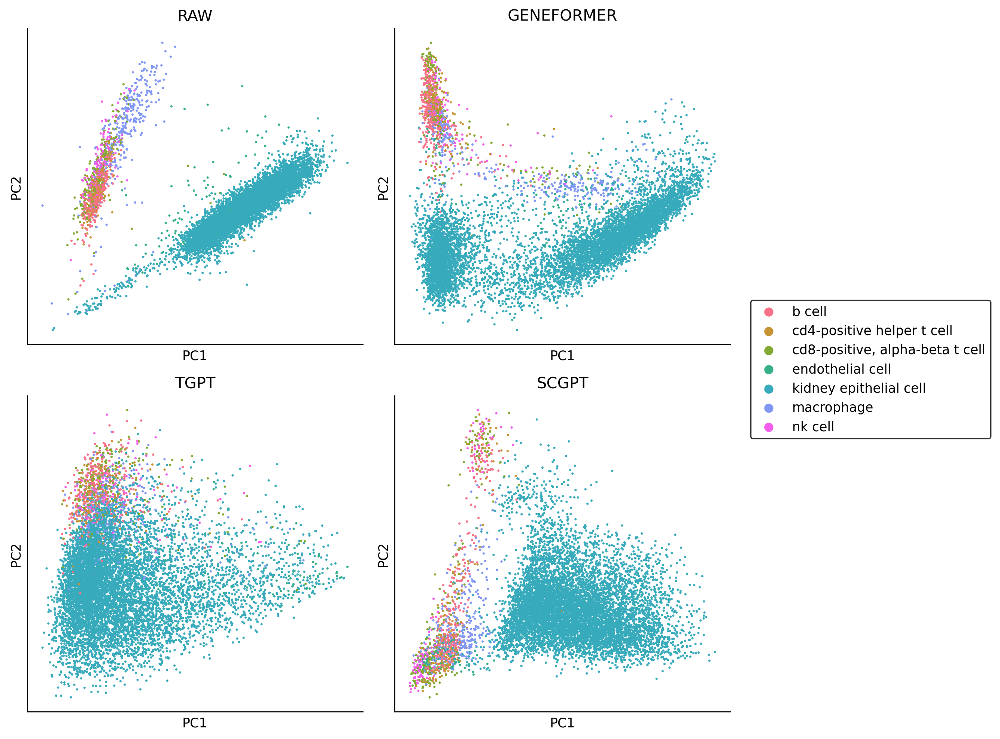

compartment


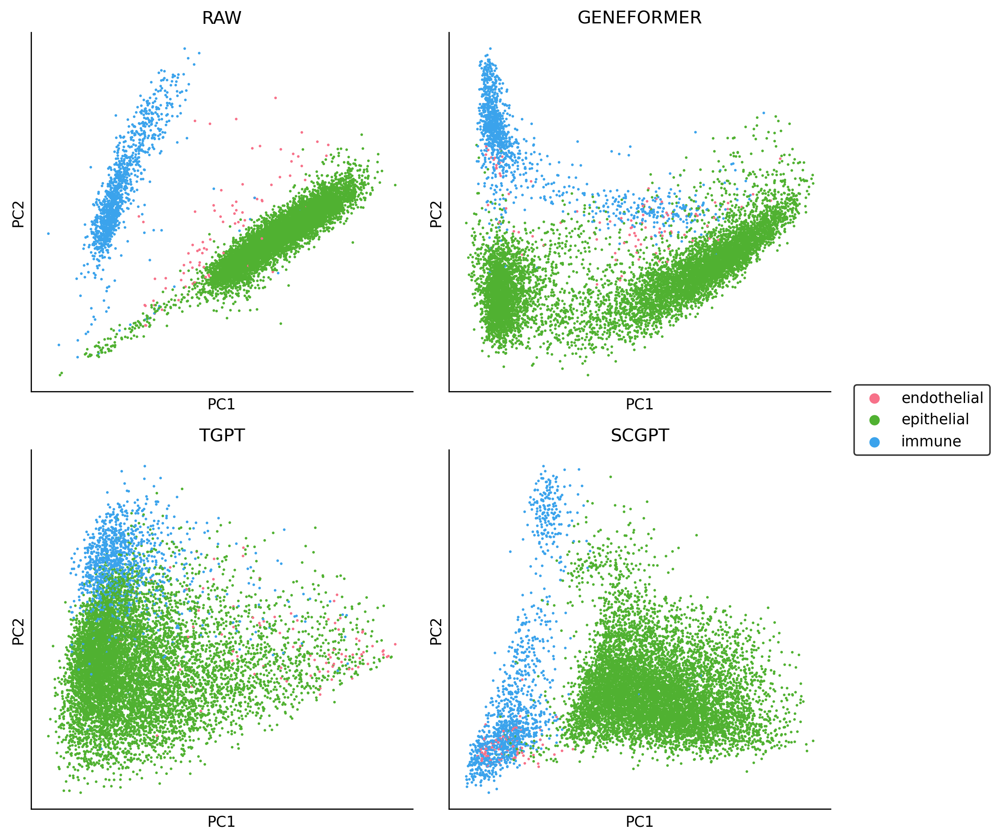

gender


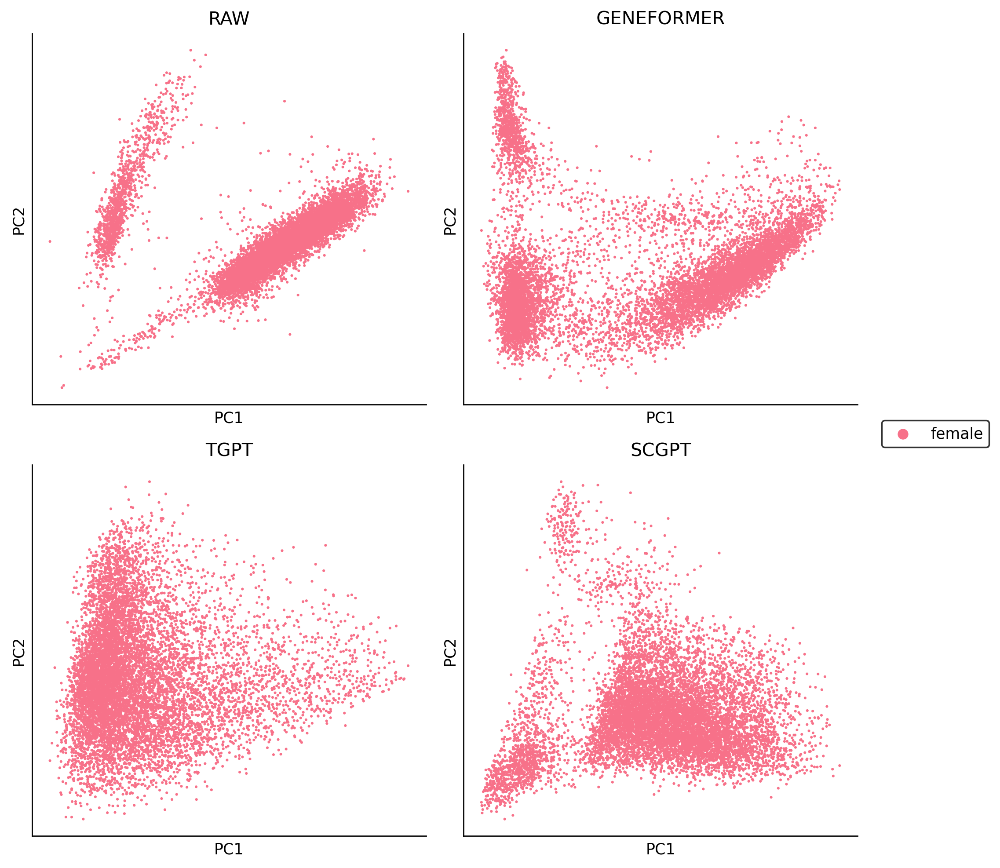

In [9]:
for attribute in ads['raw'].obs.columns:
    if attribute in ['manually_annotated']:
        continue
    print(attribute)
    plot_pca_comparison(ads, attribute=attribute)